In [11]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
from statsmodels.stats.power import FTestAnovaPower
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy import stats
import matplotlib.pyplot as plt
from scipy.stats import binomtest

In [2]:
# Set random seed for reproducibility
np.random.seed(42)

# Simulation parameters
effect_sizes = [0.3, 0.5, 0.8]  # Small, medium, large Cohen's d
sample_sizes = np.arange(20, 201, 10)  # From 20 to 200 in steps of 10
n_simulations = 1000  # Number of simulations per sample size

# Define the 7 arms
arms = ['one-sidedness', 'coalition-building', 'resilience', 
        'reputation', 'combined', 'random', 'default']

In [3]:
def simulate_ratings(n_participants, effect_size):
    """
    Simulate ratings data with specified effect size between arms
    """
    # Base rating distribution (mean=5, sd=2)
    base_ratings = np.random.normal(5, 2, size=(n_participants, len(arms)))
    
    # Add treatment effects - assume one arm is better than others
    effect_matrix = np.zeros_like(base_ratings)
    effect_matrix[:, 0] = effect_size * 2  # one-sidedness gets boost
    
    ratings = base_ratings + effect_matrix
    ratings = np.clip(ratings, 0, 10)  # clip to 0-10 scale
    
    return pd.DataFrame(ratings, columns=arms)

In [4]:
def simulate_pairwise_preferences(n_participants, effect_size):
    """
    Simulate pairwise preference data with specified effect size
    """
    n_arms = len(arms)
    n_pairs = n_arms * (n_arms - 1) // 2
    preferences = np.zeros((n_participants, n_pairs))
    
    # True underlying probabilities (Bradley-Terry model)
    # One arm is more likely to be preferred
    strengths = np.ones(n_arms)
    strengths[0] = 1 + effect_size  # one-sidedness is stronger
    
    pair_idx = 0
    for i in range(n_arms):
        for j in range(i+1, n_arms):
            prob = strengths[i] / (strengths[i] + strengths[j])
            preferences[:, pair_idx] = np.random.binomial(1, prob, n_participants)
            pair_idx += 1
    
    return preferences

In [5]:
def analyze_ratings(ratings_df):
    """
    Analyze ratings data with ANOVA and pairwise comparisons
    Returns whether significant difference was found
    """
    # Reshape data for ANOVA
    melted = ratings_df.melt(var_name='arm', value_name='rating')
    model = sm.formula.ols('rating ~ C(arm)', data=melted).fit()
    anova_result = sm.stats.anova_lm(model)
    
    # Check if ANOVA is significant
    p_value = anova_result['PR(>F)'][0]
    return p_value < 0.05

In [13]:
def analyze_pairwise(preferences, n_arms=7):
    """
    Analyze pairwise preferences with binomial tests
    Returns whether any significant difference was found
    """
    n_pairs = n_arms * (n_arms - 1) // 2
    significant = False
    
    # Test each pair with binomial test (Holm-Bonferroni correction)
    p_values = []
    for i in range(n_pairs):
        successes = int(np.sum(preferences[:, i]))  # Convert to Python int
        trials = int(len(preferences[:, i]))        # Convert to Python int
        result = binomtest(successes, trials, p=0.5, alternative='two-sided')
        p_values.append(result.pvalue)
    
    # Apply multiple testing correction
    reject, pvals_corrected, _, _ = sm.stats.multipletests(p_values, alpha=0.05, method='holm')
    
    return any(reject)

In [7]:
# Run simulations for rating analysis
power_results_ratings = {size: {es: 0 for es in effect_sizes} for size in sample_sizes}

for size in sample_sizes:
    for es in effect_sizes:
        significant_count = 0
        for _ in range(n_simulations):
            ratings = simulate_ratings(size, es)
            if analyze_ratings(ratings):
                significant_count += 1
        power_results_ratings[size][es] = significant_count / n_simulations


/var/folders/h7/97s9pgcd7xjfsk9d0kn_kkqc0000gn/T/ipykernel_86875/2255640332.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = anova_result['PR(>F)'][0]
/var/folders/h7/97s9pgcd7xjfsk9d0kn_kkqc0000gn/T/ipykernel_86875/2255640332.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = anova_result['PR(>F)'][0]
/var/folders/h7/97s9pgcd7xjfsk9d0kn_kkqc0000gn/T/ipykernel_86875/2255640332.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position,

In [14]:
# Run simulations for pairwise analysis
power_results_pairwise = {size: {es: 0 for es in effect_sizes} for size in sample_sizes}

for size in sample_sizes:
    for es in effect_sizes:
        significant_count = 0
        for _ in range(n_simulations):
            prefs = simulate_pairwise_preferences(size, es)
            if analyze_pairwise(prefs):
                significant_count += 1
        power_results_pairwise[size][es] = significant_count / n_simulations

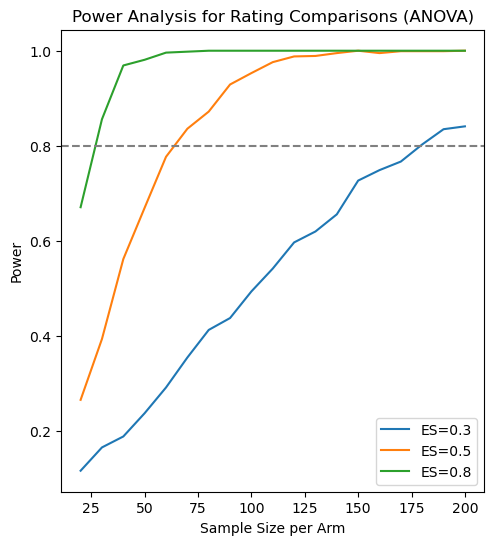

In [15]:
# Plot results
plt.figure(figsize=(12, 6))

# Rating analysis plot
plt.subplot(1, 2, 1)
for es in effect_sizes:
    powers = [power_results_ratings[size][es] for size in sample_sizes]
    plt.plot(sample_sizes, powers, label=f'ES={es}')
plt.axhline(0.8, color='gray', linestyle='--')
plt.title('Power Analysis for Rating Comparisons (ANOVA)')
plt.xlabel('Sample Size per Arm')
plt.ylabel('Power')
plt.legend()


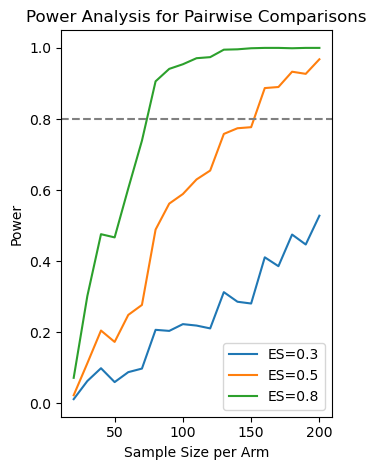

In [16]:
# Pairwise analysis plot
plt.subplot(1, 2, 2)
for es in effect_sizes:
    powers = [power_results_pairwise[size][es] for size in sample_sizes]
    plt.plot(sample_sizes, powers, label=f'ES={es}')
plt.axhline(0.8, color='gray', linestyle='--')
plt.title('Power Analysis for Pairwise Comparisons')
plt.xlabel('Sample Size per Arm')
plt.ylabel('Power')
plt.legend()

plt.tight_layout()
plt.show()


In [17]:
def ci_width(n, sigma=2, alpha=0.05):
    """Estimate 95% CI width for mean rating"""
    return 2 * stats.norm.ppf(1 - alpha/2) * sigma / np.sqrt(n)

# Calculate CI widths for different sample sizes
for n in [30, 50, 100, 150, 200]:
    print(f"Sample size {n}: CI width = {ci_width(n):.2f} points")

Sample size 30: CI width = 1.43 points
Sample size 50: CI width = 1.11 points
Sample size 100: CI width = 0.78 points
Sample size 150: CI width = 0.64 points
Sample size 200: CI width = 0.55 points
